<a href="https://colab.research.google.com/github/LollaGavrishko/Competitiveness_calculation/blob/main/OpenCV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# импортирование библиотек

In [ ]:
from tensorflow.keras.datasets import mnist
from tensorflow.keras.preprocessing import image
from google.colab import files
import numpy as np # linear algebra
import matplotlib.pyplot as plt
from PIL import Image
import cv2
from google.colab.patches import cv2_imshow
%matplotlib inline

In [ ]:
smile = [[0, 0, 1, 1, 1, 1, 1, 1, 0, 0], # набор данных в матрице
         [0, 1, 0, 0, 0, 0, 0, 0, 1, 0],
         [1, 0, 0, 0, 0, 0, 0, 0, 0, 1],
         [1, 0, 0, 1, 0, 0, 1, 0, 0, 1],
         [1, 0, 0, 0, 0, 0, 0, 0, 0, 1],
         [1, 0, 0, 0, 0, 0, 0, 0, 0, 1],
         [1, 0, 1, 0, 0, 0, 0, 1, 0, 1],
         [1, 0, 0, 1, 1, 1, 1, 0, 0, 1],
         [0, 1, 0, 0, 0, 0, 0, 0, 1, 0],
         [0, 0, 1, 1, 1, 1, 1, 1, 0, 0]]

In [ ]:
type(smile)

list

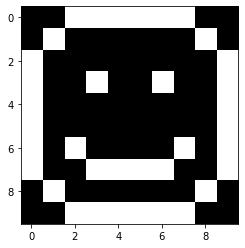

In [ ]:
fig, ax = plt.subplots()
ax.imshow(smile, cmap='gray') # 0 - отображаются черным цветом, 1 - белым
plt.show()

#Загружаем MNIST датасета

In [ ]:
(x_train, y_train), (x_test, y_test) = mnist.load_data()

11490434/11490434 [==============================] - 1s 0us/step


In [ ]:
type(x_train)

numpy.ndarray

In [ ]:
x_train[17]

array([[  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,  11, 203, 229,  32,   0,   0,   0,
          0,   0],
       [  

In [ ]:
y_train[17]

8

# отображение изображения

вариант 1

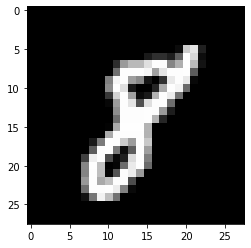

In [ ]:
n = 17
plt.imshow(Image.fromarray(x_train[n]).convert('RGB'))
plt.show()

вариант 2 с белым фоном

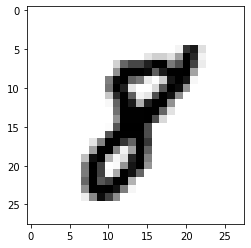

In [ ]:
digit = x_train[17]
plt.imshow(digit, cmap=plt.cm.binary)
plt.show()

In [ ]:
digit.shape

(28, 28)

In [ ]:
#  часть изображений от 1 до 10
my_slice = x_train[1:10]
my_slice.shape

(9, 28, 28)

# Управление тензорами в Numpy

Тензорная нарезка

Можно выбирать между любыми двумя индексами вдоль каждой оси тензора

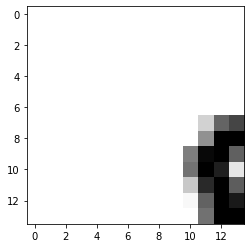

In [ ]:
my_slice = x_train[:, :14, :14] #
digit_slice = my_slice[17]
plt.imshow(digit_slice, cmap=plt.cm.binary)
plt.show()

In [ ]:
my_slice.shape

(60000, 14, 14)

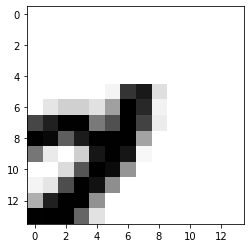

In [ ]:
my_slice = x_train[:, :14, 14:] # верхний правый угол всех изображений
digit_slice = my_slice[17]
plt.imshow(digit_slice, cmap=plt.cm.binary)
plt.show()

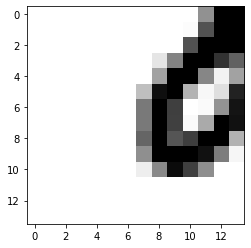

In [ ]:
my_slice = x_train[:, 14:, :14] #  нижний левый угол всех изображений
digit_slice = my_slice[17]
plt.imshow(digit_slice, cmap=plt.cm.binary)
plt.show()

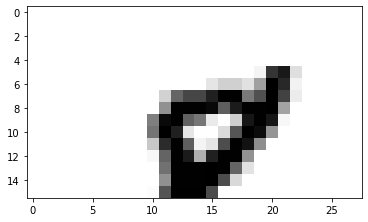

In [ ]:
my_slice_up = x_train[:, :16, :] # верхняя часть
digit_slice = my_slice_up[17]
plt.imshow(digit_slice, cmap=plt.cm.binary)
plt.show()

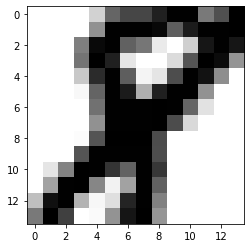

In [ ]:
my_slice_centre = x_train[:, 7:-7, 7:-7] # центр
centre_slice = my_slice_centre[17]
plt.imshow(centre_slice, cmap=plt.cm.binary)
plt.show()

# загрузка изображения

In [ ]:
# загрузка файла с локального диска
uploaded = files.upload()

Saving 1582888810_priroda-1920x1080-priroda-21456.jpg to 1582888810_priroda-1920x1080-priroda-21456.jpg


In [ ]:
# подключение Google drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp '/content/drive/My Drive/Изображения/1582888810_priroda-1920x1080-priroda-21456.jpg'

cp: missing destination file operand after '/content/drive/My Drive/Изображения/1582888810_priroda-1920x1080-priroda-21456.jpg'
Try 'cp --help' for more information.


In [ ]:
!ls

1582888810_priroda-1920x1080-priroda-21456.jpg	drive  sample_data


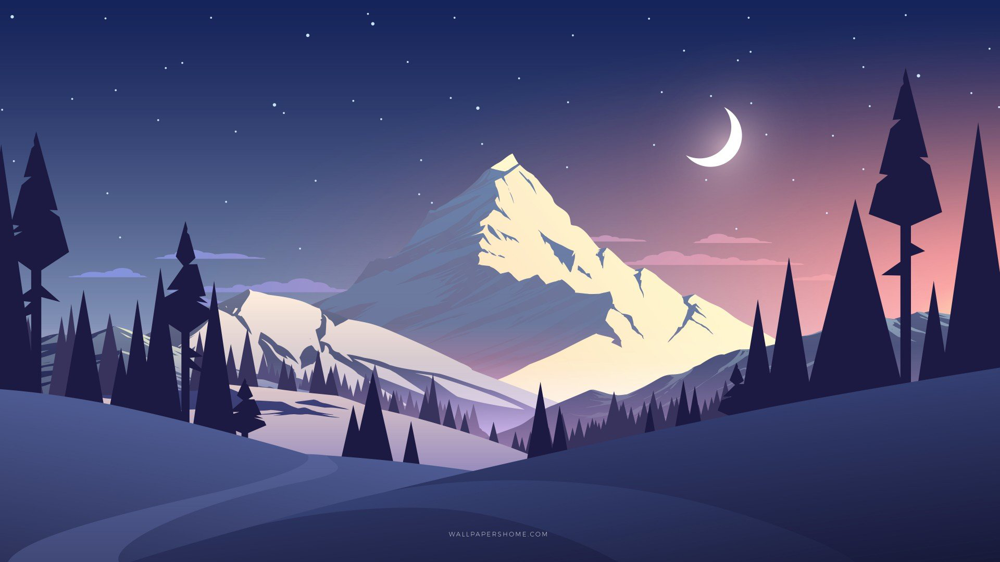

In [ ]:
img=Image.open('1582888810_priroda-1920x1080-priroda-21456.jpg')
display(img)

In [ ]:
type(img)

PIL.JpegImagePlugin.JpegImageFile

In [ ]:
img.size

(1920, 1080)

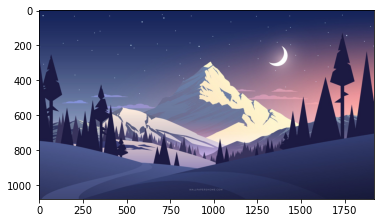

In [ ]:
plt.imshow(img)
plt.show()

In [ ]:
img_array=image.img_to_array(img)

In [ ]:
img_array

array([[[21., 36., 91.],
        [21., 36., 91.],
        [21., 36., 91.],
        ...,
        [21., 36., 91.],
        [21., 36., 91.],
        [21., 36., 91.]],

       [[21., 36., 91.],
        [21., 36., 91.],
        [21., 36., 91.],
        ...,
        [21., 36., 91.],
        [21., 36., 91.],
        [21., 36., 91.]],

       [[21., 36., 91.],
        [21., 36., 91.],
        [21., 36., 91.],
        ...,
        [21., 36., 91.],
        [21., 36., 91.],
        [21., 36., 91.]],

       ...,

       [[45., 50., 92.],
        [45., 50., 92.],
        [45., 50., 92.],
        ...,
        [24., 27., 58.],
        [24., 27., 58.],
        [24., 27., 58.]],

       [[45., 50., 92.],
        [45., 50., 92.],
        [45., 50., 92.],
        ...,
        [23., 26., 57.],
        [23., 26., 57.],
        [23., 26., 57.]],

       [[45., 50., 92.],
        [45., 50., 92.],
        [45., 50., 92.],
        ...,
        [23., 26., 57.],
        [23., 26., 57.],
        [23., 26., 57.]]

In [ ]:
type(img_array)

numpy.ndarray

In [ ]:
img_array = img_array.astype('uint8')

In [ ]:
img_array.shape

(1080, 1920, 3)

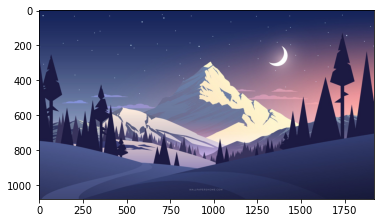

In [ ]:
plt.imshow(Image.fromarray(img_array).convert('RGB'))
plt.show()

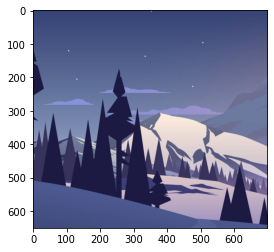

In [ ]:
slice_img = img_array[250:900, 100:800] # по оси Y, по оси Х
plt.imshow(slice_img, cmap=plt.cm.binary)
plt.show()

# задание 1

In [ ]:
from tensorflow.keras.datasets import mnist
from tensorflow.keras.preprocessing import image
from google.colab import files
import numpy as np # линейная алгебра
import matplotlib.pyplot as plt
from PIL import Image
import cv2 # OpenCV компьютерное зрение
from google.colab.patches import cv2_imshow
%matplotlib inline

In [ ]:
uploaded = files.upload()# загрузка файла первым споособом

Saving фрукт.jpg to фрукт.jpg


In [ ]:
!ls

 1582888810_priroda-1920x1080-priroda-21456.jpg   sample_data	 котики2.jpg
 archive_data_img2.zip				  еда1.jpg	 котики3.jpg
 archive_data_img.zip				 'еда (1).jpg'	 краски.jpg
 data_img					  еда.jpg	 куница.jpg
 drive						  котики1.jpg	 фрукт.jpg


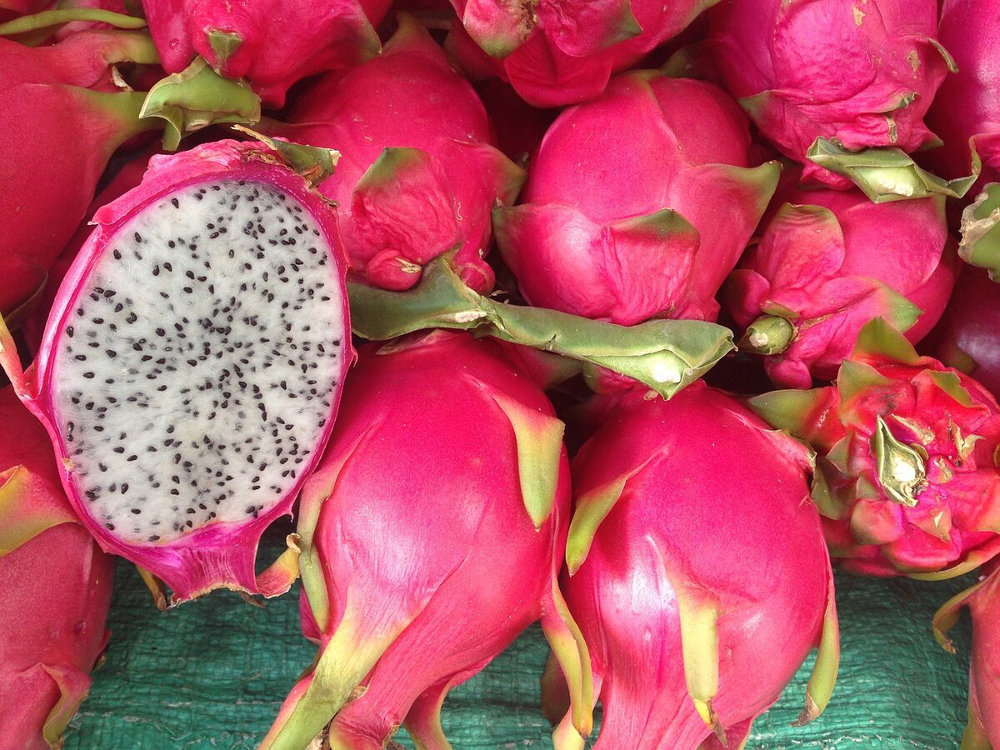

In [ ]:
img=Image.open('фрукт.jpg')
display(img)

In [ ]:
img.size

(1200, 900)

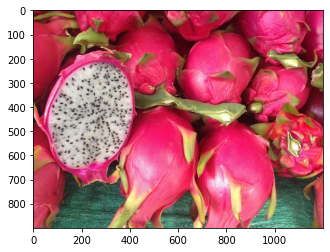

In [ ]:
plt.imshow(img)
plt.show()

In [ ]:
img_array=image.img_to_array(img)

In [ ]:
type(img_array)

numpy.ndarray

In [ ]:
img_array.dtype

dtype('float32')

In [ ]:
img_array = img_array.astype('uint8')

In [ ]:
img_array.dtype

dtype('uint8')

In [ ]:
img_array.shape

(900, 1200, 3)

In [ ]:
img_array.shape[0] # количество пикселей вдоль линий

900

In [ ]:
img_array.shape[1] # количество пикселей вдоль столбцов

1200

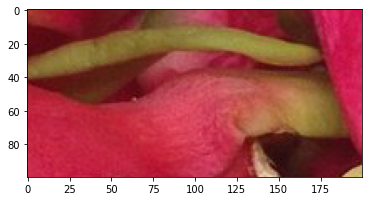

In [ ]:
slice_img = img_array[:100, 0:200] # [250:750, 150:1100] [:800, 1000:1700] [600:850, 200:450]
plt.imshow(slice_img)
plt.show()

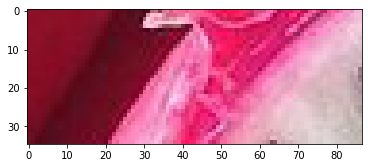

In [ ]:
slice_img = img_array[265:300, 75:162]
plt.imshow(slice_img)
plt.show()

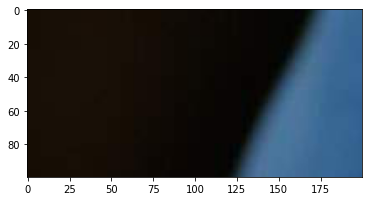

In [ ]:
slice_img = img_array[:100, 0:200] # фрагмент изображения
plt.imshow(slice_img)
#plt.show()

In [ ]:
# создать каталог для сохранения результатов извлечения области изображения
!mkdir data_img

mkdir: cannot create directory ‘data_img’: File exists


In [ ]:
!ls

 1582888810_priroda-1920x1080-priroda-21456.jpg   sample_data	 котики2.jpg
 archive_data_img2.zip				  еда1.jpg	 котики3.jpg
 archive_data_img.zip				 'еда (1).jpg'	 краски.jpg
 data_img					  еда.jpg	 куница.jpg
 drive						  котики1.jpg	 фрукт.jpg


step_row =  0
step_col =  0


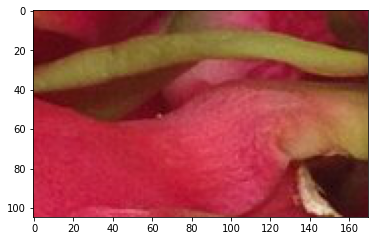

step_col =  150


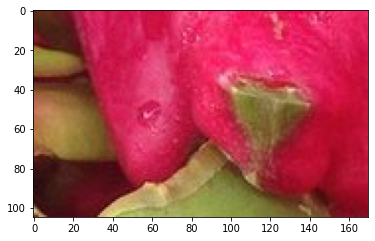

step_col =  300


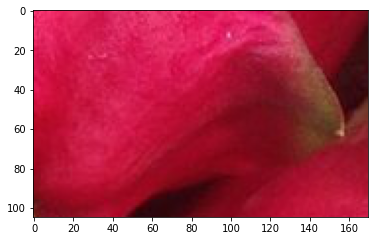

step_col =  450


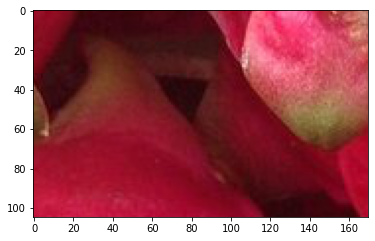

step_col =  600


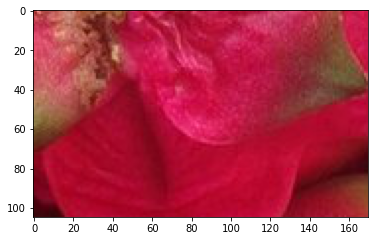

step_col =  750


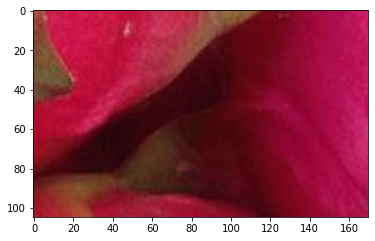

step_col =  900


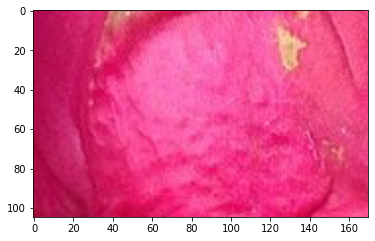

step_col =  1050


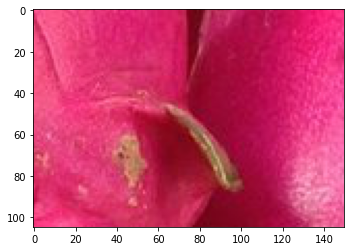

step_row =  100
step_col =  0


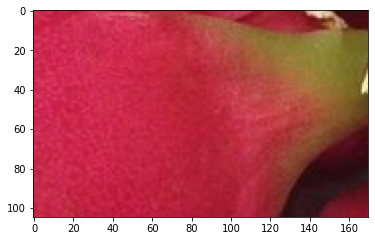

step_col =  150


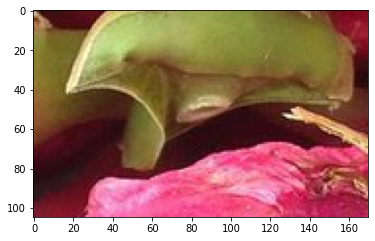

step_col =  300


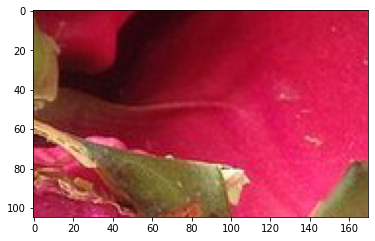

step_col =  450


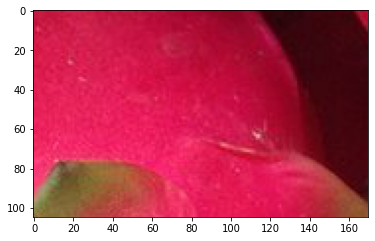

step_col =  600


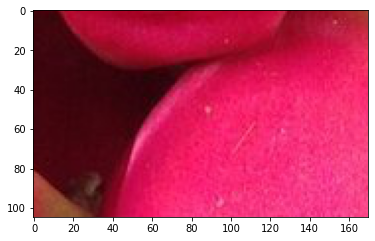

step_col =  750


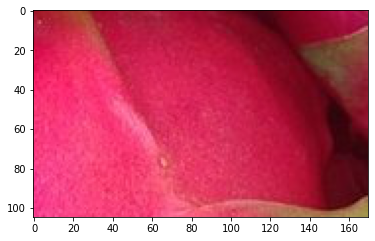

step_col =  900


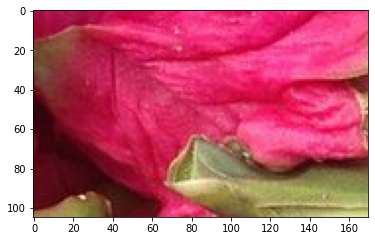

step_col =  1050


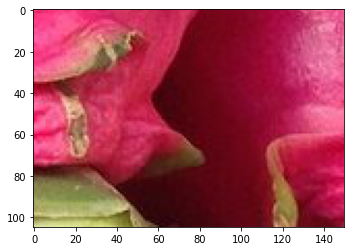

step_row =  200
step_col =  0


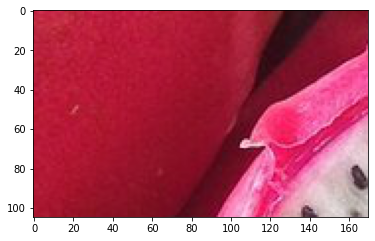

step_col =  150


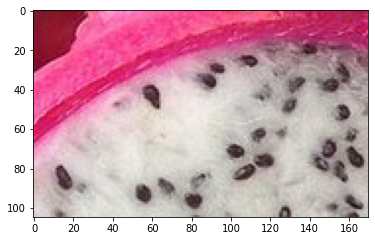

step_col =  300


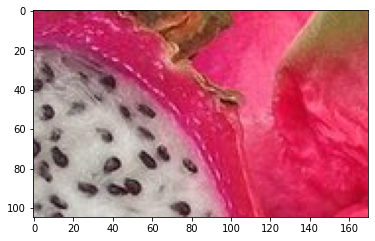

step_col =  450


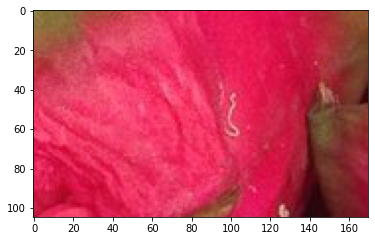

step_col =  600


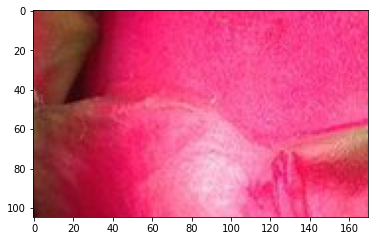

step_col =  750


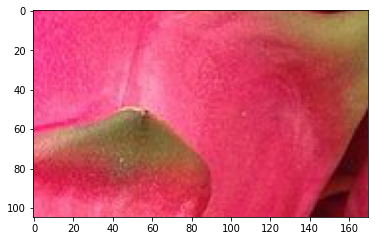

step_col =  900


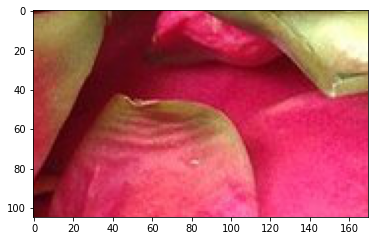

step_col =  1050


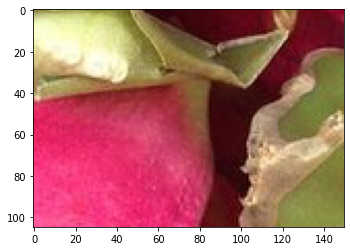

step_row =  300
step_col =  0


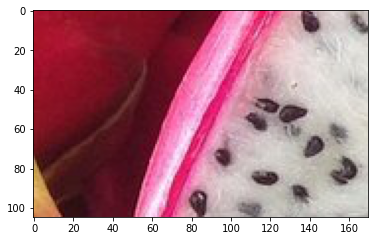

step_col =  150


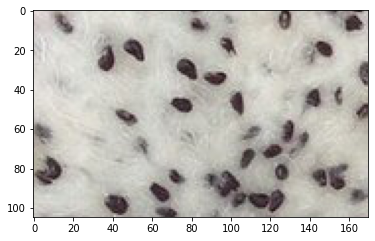

step_col =  300


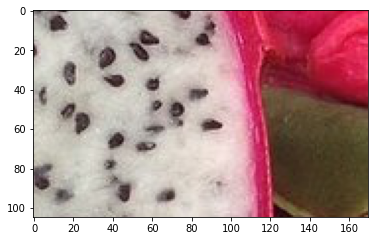

step_col =  450


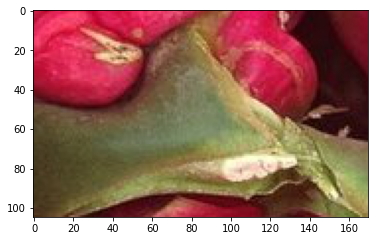

step_col =  600


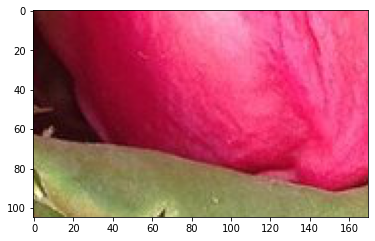

step_col =  750


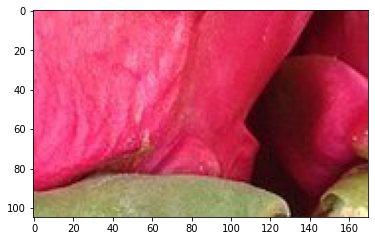

step_col =  900


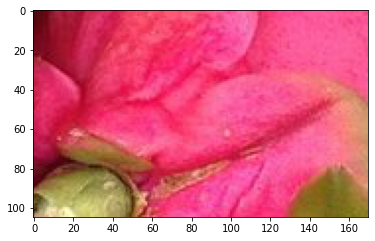

step_col =  1050


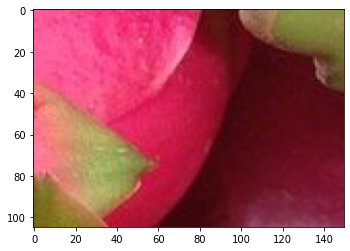

step_row =  400
step_col =  0


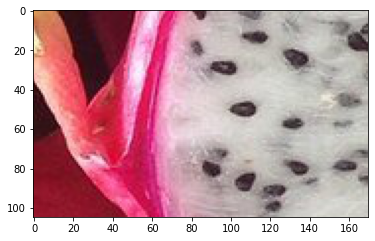

step_col =  150


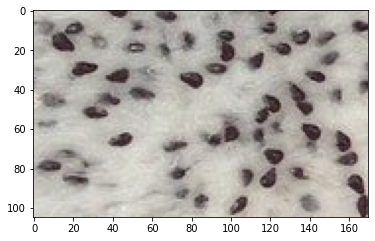

step_col =  300


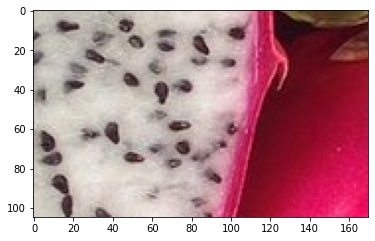

step_col =  450


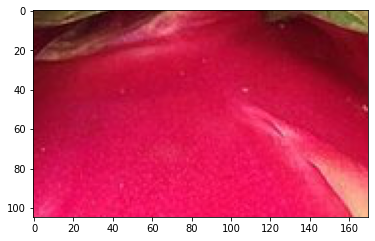

step_col =  600


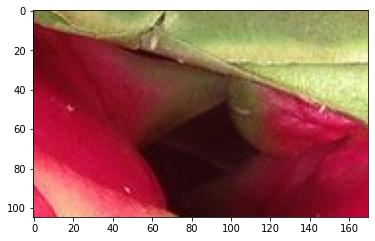

step_col =  750


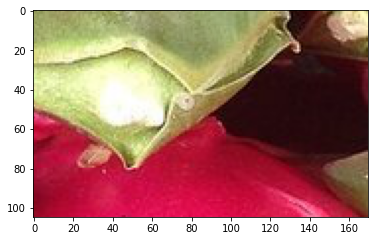

step_col =  900


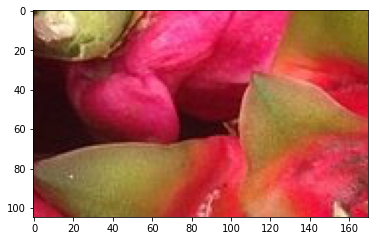

step_col =  1050


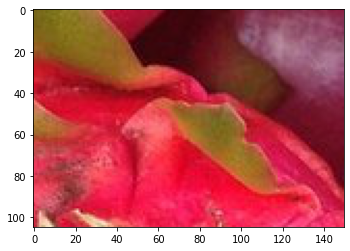

step_row =  500
step_col =  0


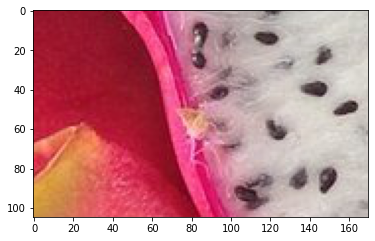

step_col =  150


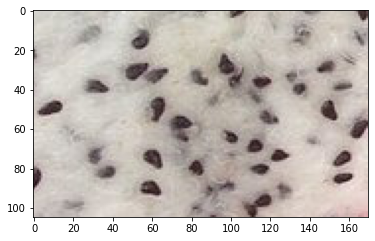

step_col =  300


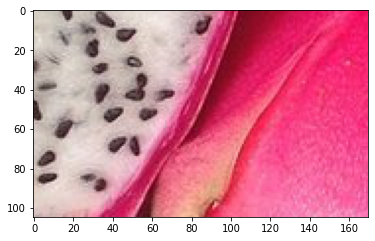

step_col =  450


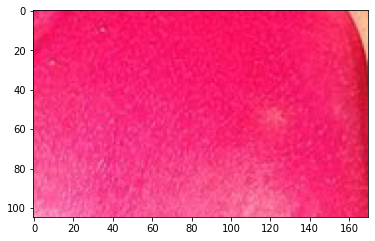

step_col =  600


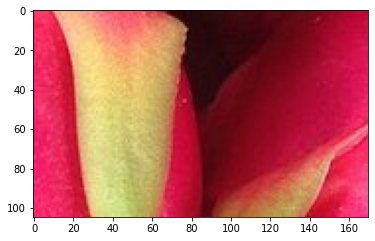

step_col =  750


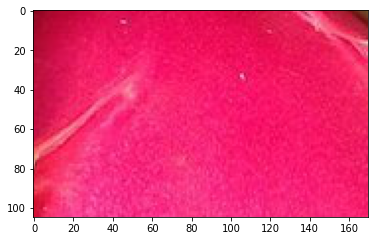

step_col =  900


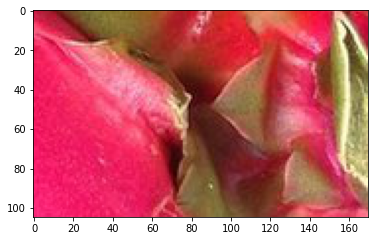

step_col =  1050


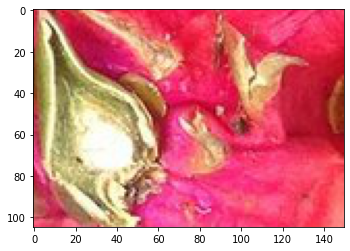

step_row =  600
step_col =  0


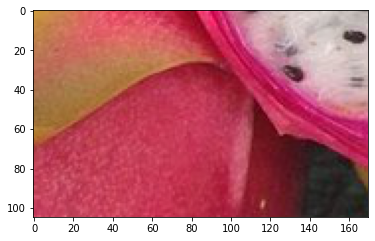

step_col =  150


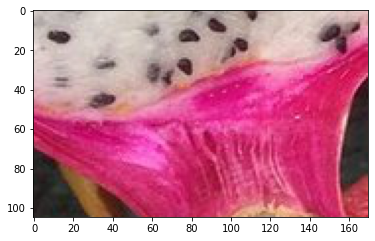

step_col =  300


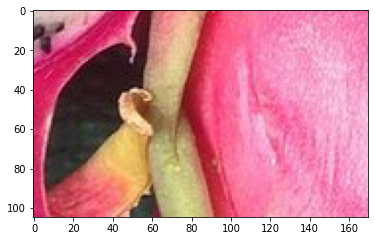

step_col =  450


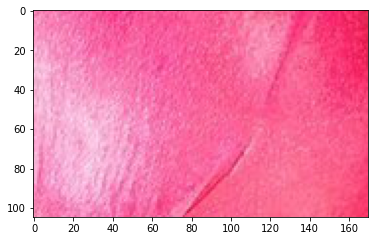

step_col =  600


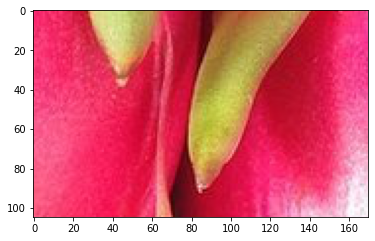

step_col =  750


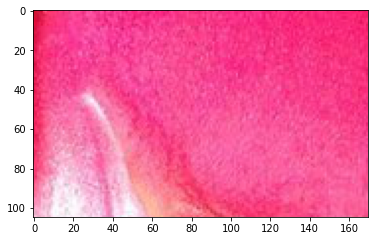

step_col =  900


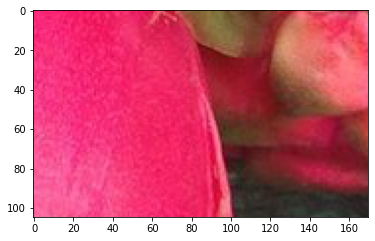

step_col =  1050


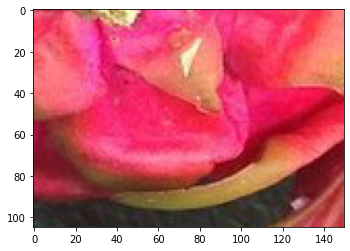

step_row =  700
step_col =  0


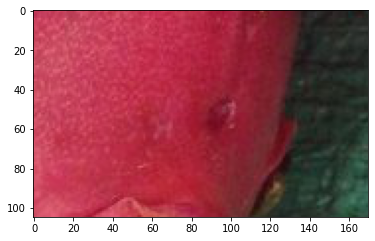

step_col =  150


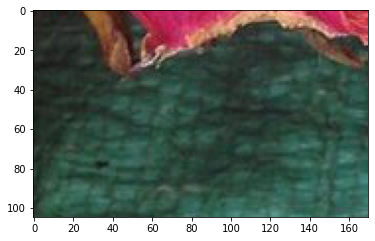

step_col =  300


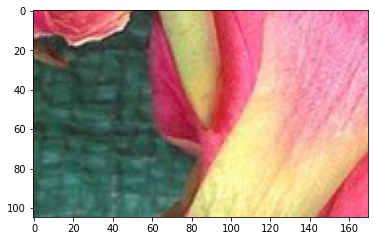

step_col =  450


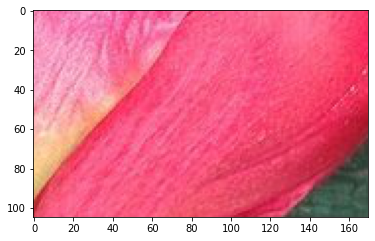

step_col =  600


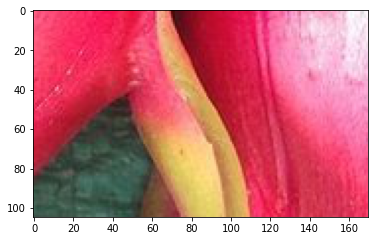

step_col =  750


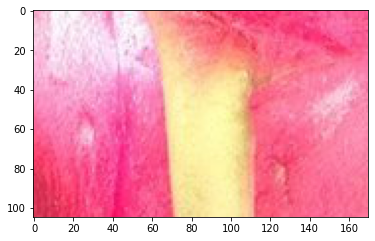

step_col =  900


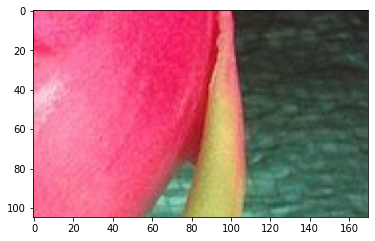

step_col =  1050


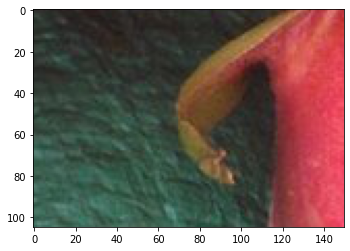

step_row =  800
step_col =  0


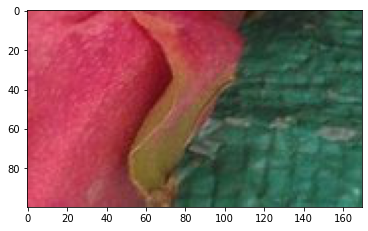

step_col =  150


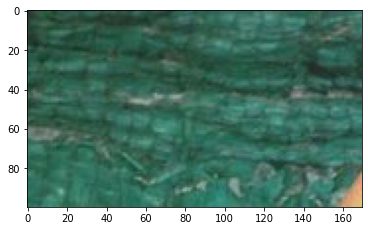

step_col =  300


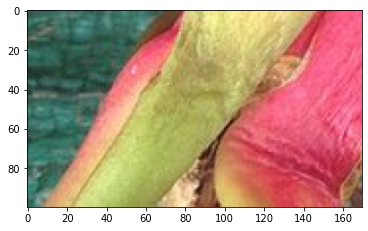

step_col =  450


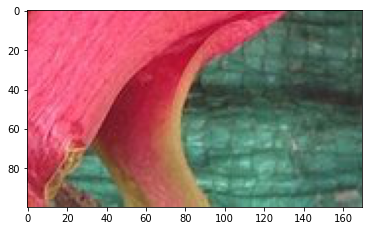

step_col =  600


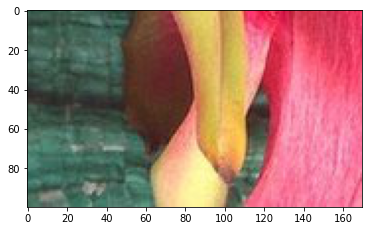

step_col =  750


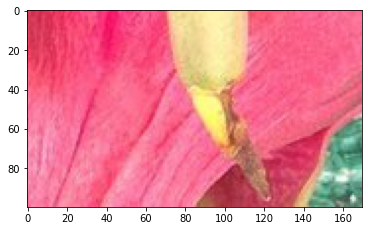

step_col =  900


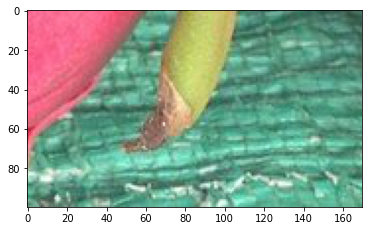

step_col =  1050


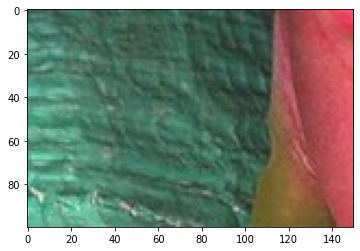

In [ ]:
len_row = img_array.shape[0] # количество пикселей вдоль линий
len_col = img_array.shape[1] # количество пикселей вдоль столбцов
step_row = 100 # шаг линии
step_col = 150 # шаг колонны
n=0 # счетчик изображений
for i in range(0, len_row, step_row):
  print("step_row = ", i)
  for j in range(0, len_col, step_col):
    print("step_col = ", j)
    n=n+1
    my_slice_flow = img_array[0+i:105+i, 0+j:170+j] # контроль размера изображения
    flow_slice = my_slice_flow
    # сохранить фрагменты изображения в директорию
    cv2.imwrite('data_img/' + 'img_'+ str(n) +'.jpg', flow_slice)
    plt.imshow(flow_slice)
    plt.show()

In [ ]:
import os
# содержимое папки data_img
print(os.listdir('data_img'))

['img_37.jpg', 'img_226.jpg', 'img_165.jpg', 'img_36.jpg', 'img_83.jpg', 'img_139.jpg', 'img_215.jpg', 'img_231.jpg', 'img_194.jpg', 'img_56.jpg', 'img_220.jpg', 'img_14.jpg', 'img_164.jpg', 'img_116.jpg', 'img_43.jpg', 'img_141.jpg', 'img_50.jpg', 'img_154.jpg', 'img_178.jpg', 'img_30.jpg', 'img_93.jpg', 'img_187.jpg', 'img_76.jpg', 'img_199.jpg', 'img_225.jpg', 'img_125.jpg', 'img_58.jpg', 'img_90.jpg', 'img_74.jpg', 'img_142.jpg', 'img_91.jpg', 'img_11.jpg', 'img_126.jpg', 'img_221.jpg', 'img_123.jpg', 'img_59.jpg', 'img_182.jpg', 'img_115.jpg', 'img_73.jpg', 'img_55.jpg', 'img_196.jpg', 'img_212.jpg', 'img_134.jpg', 'img_143.jpg', 'img_1.jpg', 'img_26.jpg', 'img_6.jpg', 'img_144.jpg', 'img_31.jpg', 'img_132.jpg', 'img_105.jpg', 'img_4.jpg', 'img_101.jpg', 'img_174.jpg', 'img_79.jpg', 'img_205.jpg', 'img_151.jpg', 'img_140.jpg', 'img_127.jpg', 'img_98.jpg', 'img_177.jpg', 'img_38.jpg', 'img_118.jpg', 'img_219.jpg', 'img_85.jpg', 'img_92.jpg', 'img_160.jpg', 'img_153.jpg', 'img_33.jp

In [ ]:
# подсчитать количество файлов в наборе данных
!find /content/data_img/ -type f| wc -l

240


In [ ]:
# запаковать директорию в zip архив (сжатие от 1 до 9)
!zip -r -9 archive_data_img.zip /content/data_img/*

updating: content/data_img/img_100.jpg (deflated 5%)
updating: content/data_img/img_101.jpg (deflated 6%)
updating: content/data_img/img_102.jpg (deflated 5%)
updating: content/data_img/img_103.jpg (deflated 3%)
updating: content/data_img/img_104.jpg (deflated 5%)
updating: content/data_img/img_105.jpg (deflated 6%)
updating: content/data_img/img_106.jpg (deflated 4%)
updating: content/data_img/img_107.jpg (deflated 4%)
updating: content/data_img/img_108.jpg (deflated 4%)
updating: content/data_img/img_109.jpg (deflated 5%)
updating: content/data_img/img_10.jpg (deflated 2%)
updating: content/data_img/img_110.jpg (deflated 5%)
updating: content/data_img/img_111.jpg (deflated 4%)
updating: content/data_img/img_112.jpg (deflated 5%)
updating: content/data_img/img_113.jpg (deflated 8%)
updating: content/data_img/img_114.jpg (deflated 5%)
updating: content/data_img/img_115.jpg (deflated 9%)
updating: content/data_img/img_116.jpg (deflated 6%)
updating: content/data_img/img_117.jpg (deflate

In [ ]:
# скачать архив на локальный диск
files.download('archive_data_img.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# скопировать архив на гугл диск
# cp 'путь - > откуда' 'путь - > куда'
!cp '/content/archive_data_img.zip' '/content/drive/MyDrive/Colab Notebooks'

# второй датасет первого задания

In [ ]:
uploaded = files.upload()# загрузка файла первым споособом

Saving котики2.jpg to котики2.jpg


In [ ]:
!ls

 1582888810_priroda-1920x1080-priroda-21456.jpg   drive		 еда.jpg
 archive_data_img2.zip				  sample_data	 котики1.jpg
 archive_data_img.zip				  еда1.jpg	 котики2.jpg
 data_img					 'еда (1).jpg'	 краски.jpg


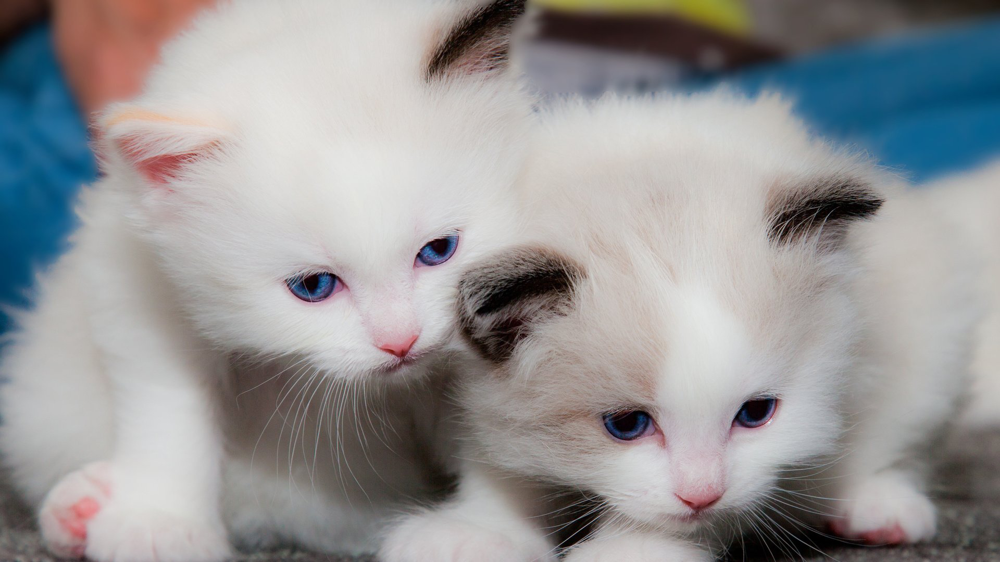

In [ ]:
img=Image.open('котики2.jpg')
display(img)

In [ ]:
img.size

(1920, 1080)

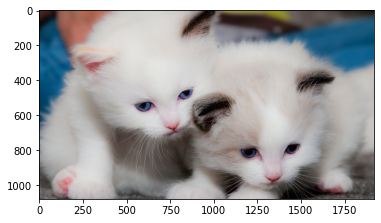

In [ ]:
plt.imshow(img)
plt.show()

# задание 2

In [ ]:
from tensorflow.keras.datasets import mnist
from tensorflow.keras.preprocessing import image
from google.colab import files
import numpy as np # linear algebra
import matplotlib.pyplot as plt
from PIL import Image
import cv2
from google.colab.patches import cv2_imshow
%matplotlib inline

In [ ]:
uploaded = files.upload()

Saving куница.jpg to куница.jpg


In [ ]:

from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
#путь к файлу
!cp '/content/drive/MyDrive/Colab Notebooks/куница.jpg'

cp: missing destination file operand after '/content/drive/MyDrive/Colab Notebooks/куница.jpg'
Try 'cp --help' for more information.


In [ ]:
!ls

 1582888810_priroda-1920x1080-priroda-21456.jpg   sample_data	 котики2.jpg
 archive_data_img2.zip				  еда1.jpg	 котики3.jpg
 archive_data_img.zip				 'еда (1).jpg'	 краски.jpg
 data_img					  еда.jpg	 куница.jpg
 drive						  котики1.jpg


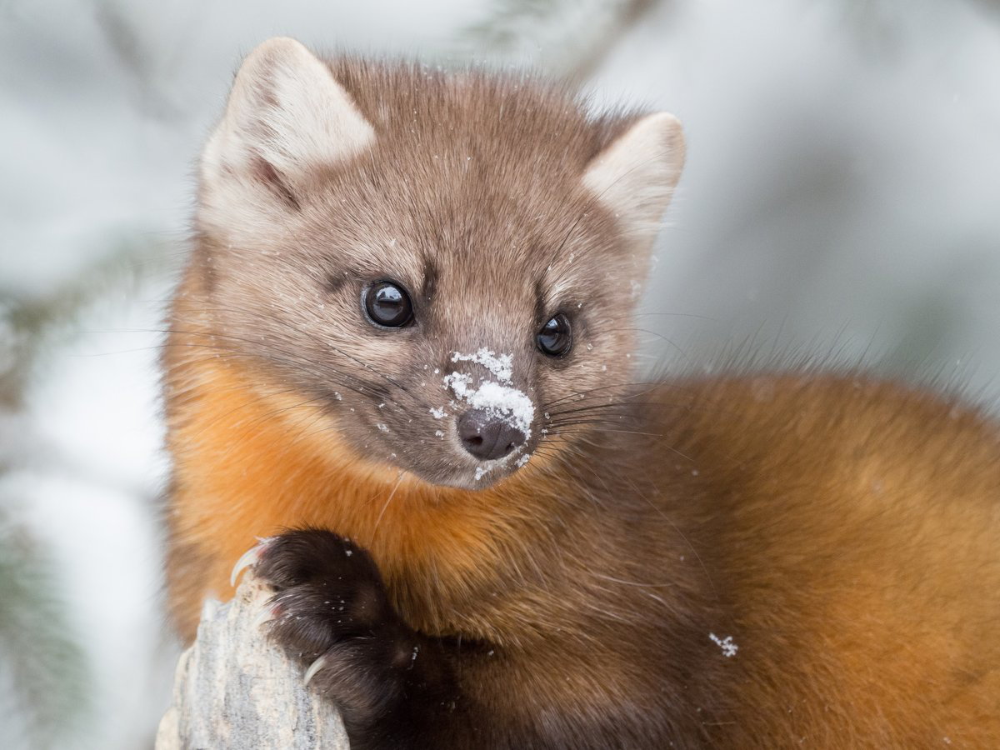

In [ ]:
img=Image.open('куница.jpg')
display(img)

In [ ]:
img.size

(1200, 900)

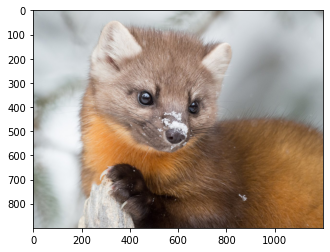

In [ ]:
plt.imshow(img)
plt.show()

In [ ]:
img_array=image.img_to_array(img)

In [ ]:
type(img_array)

numpy.ndarray

In [ ]:
img_array = img_array.astype('uint8')

In [ ]:
img_array.shape

(900, 1200, 3)

In [ ]:
img_array.shape[0] # количество пикселей вдоль линий

900

In [ ]:
img_array.shape[1] # количество пикселей вдоль столбцов

1200

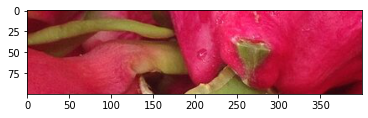

In [ ]:
slice_img = img_array[:100, 0:400] # фрагмент изображения
plt.imshow(slice_img, cmap=plt.cm.binary)
plt.show()

In [ ]:
# создать каталог для сохранения результатов извлечения области изображения
!mkdir data_img

mkdir: cannot create directory ‘data_img’: File exists


In [ ]:
!ls

 1582888810_priroda-1920x1080-priroda-21456.jpg   sample_data	 котики2.jpg
 archive_data_img2.zip				  еда1.jpg	 котики3.jpg
 archive_data_img.zip				 'еда (1).jpg'	 краски.jpg
 data_img					  еда.jpg	 куница.jpg
 drive						  котики1.jpg	 фрукт.jpg


step_row =  0
step_col =  0


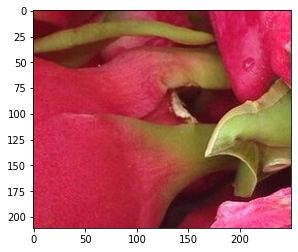

step_col =  257


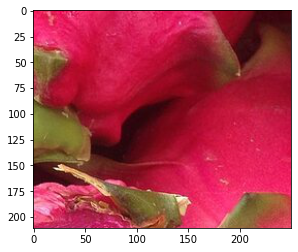

step_col =  514


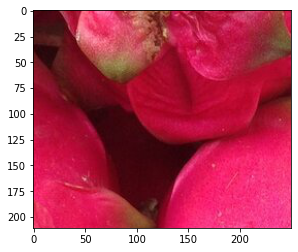

step_col =  771


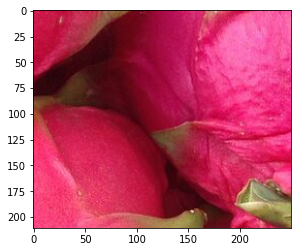

step_col =  1028


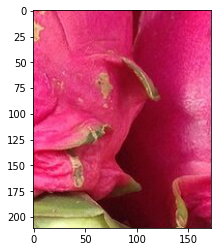

step_row =  211
step_col =  0


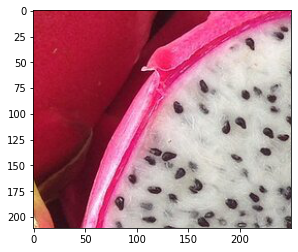

step_col =  257


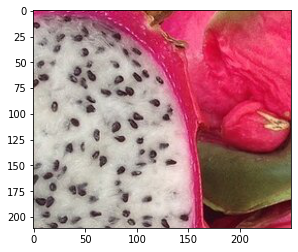

step_col =  514


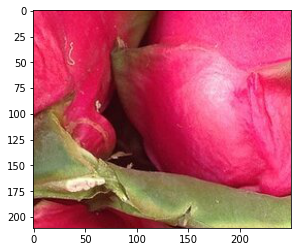

step_col =  771


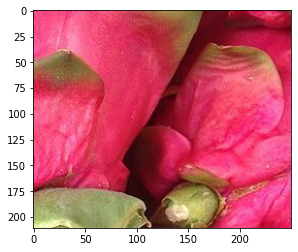

step_col =  1028


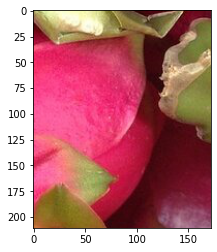

step_row =  422
step_col =  0


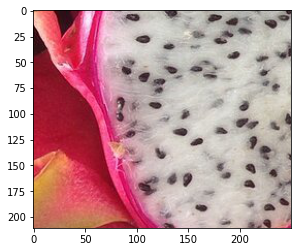

step_col =  257


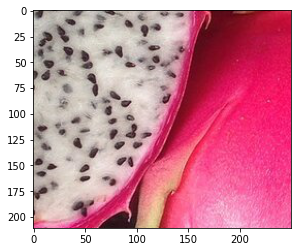

step_col =  514


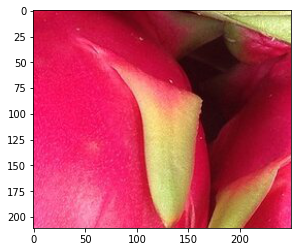

step_col =  771


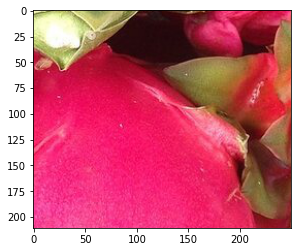

step_col =  1028


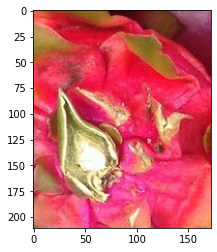

step_row =  633
step_col =  0


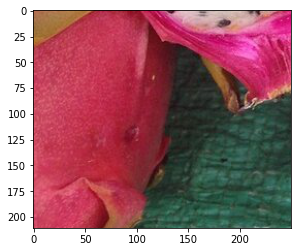

step_col =  257


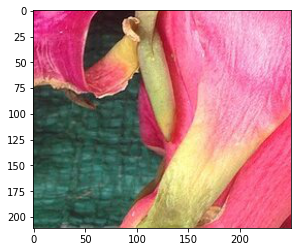

step_col =  514


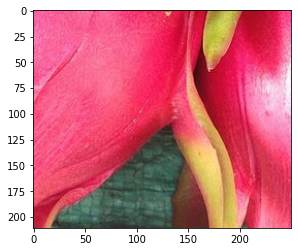

step_col =  771


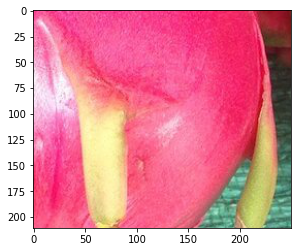

step_col =  1028


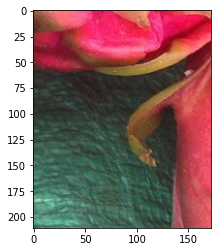

step_row =  844
step_col =  0


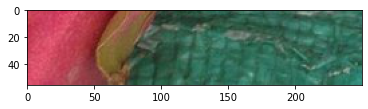

step_col =  257


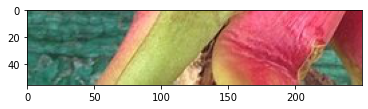

step_col =  514


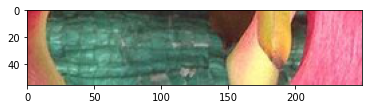

step_col =  771


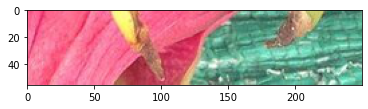

step_col =  1028


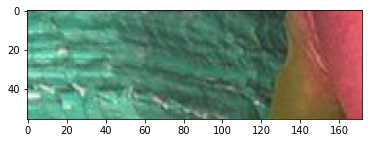

In [ ]:
len_row = img_array.shape[0] #количество пикселей вдоль линий
len_col = img_array.shape[1] # количество пикселей вдоль столбцов
step_row = 211 # шаг линии
step_col = 257 # шаг колонны
n=0 # счетчик изображений
for i in range(0, len_row, step_row):
  print("step_row = ", i)
  for j in range(0, len_col, step_col):
    print("step_col = ", j)
    n=n+1
    my_slice_flow = img_array[0+i:211+i, 0+j:250+j] # контроль размера изображения
    flow_slice = my_slice_flow
    # для корректного отображения цветов изображения конвертируем цвета в BGR
    image_to_write = cv2.cvtColor(flow_slice, cv2.COLOR_RGB2BGR)
    # сохранить фрагменты изображения в директорию
    cv2.imwrite('data_img/' + 'img_'+ str(n) +'.jpg', image_to_write)
    plt.imshow(flow_slice, cmap=plt.cm.binary)
    plt.show()

In [ ]:
import os
# содержимое папки data_img
print(os.listdir('data_img'))

['img_37.jpg', 'img_226.jpg', 'img_165.jpg', 'img_36.jpg', 'img_83.jpg', 'img_139.jpg', 'img_215.jpg', 'img_231.jpg', 'img_194.jpg', 'img_56.jpg', 'img_220.jpg', 'img_14.jpg', 'img_164.jpg', 'img_116.jpg', 'img_43.jpg', 'img_141.jpg', 'img_50.jpg', 'img_154.jpg', 'img_178.jpg', 'img_30.jpg', 'img_93.jpg', 'img_187.jpg', 'img_76.jpg', 'img_199.jpg', 'img_225.jpg', 'img_125.jpg', 'img_58.jpg', 'img_90.jpg', 'img_74.jpg', 'img_142.jpg', 'img_91.jpg', 'img_11.jpg', 'img_126.jpg', 'img_221.jpg', 'img_123.jpg', 'img_59.jpg', 'img_182.jpg', 'img_115.jpg', 'img_73.jpg', 'img_55.jpg', 'img_196.jpg', 'img_212.jpg', 'img_134.jpg', 'img_143.jpg', 'img_1.jpg', 'img_26.jpg', 'img_6.jpg', 'img_144.jpg', 'img_31.jpg', 'img_132.jpg', 'img_105.jpg', 'img_4.jpg', 'img_101.jpg', 'img_174.jpg', 'img_79.jpg', 'img_205.jpg', 'img_151.jpg', 'img_140.jpg', 'img_127.jpg', 'img_98.jpg', 'img_177.jpg', 'img_38.jpg', 'img_118.jpg', 'img_219.jpg', 'img_85.jpg', 'img_92.jpg', 'img_160.jpg', 'img_153.jpg', 'img_33.jp

In [ ]:
# подсчитать количество файлов в наборе данных
!find /content/data_img/ -type f| wc -l

240


In [ ]:
# запаковать директорию в zip архив (сжатие от 1 до 9)
!zip -r -9 archive_data_img2.zip /content/data_img/*

updating: content/data_img/img_100.jpg (deflated 5%)
updating: content/data_img/img_101.jpg (deflated 6%)
updating: content/data_img/img_102.jpg (deflated 5%)
updating: content/data_img/img_103.jpg (deflated 3%)
updating: content/data_img/img_104.jpg (deflated 5%)
updating: content/data_img/img_105.jpg (deflated 6%)
updating: content/data_img/img_106.jpg (deflated 4%)
updating: content/data_img/img_107.jpg (deflated 4%)
updating: content/data_img/img_108.jpg (deflated 4%)
updating: content/data_img/img_109.jpg (deflated 5%)
updating: content/data_img/img_10.jpg (deflated 1%)
updating: content/data_img/img_110.jpg (deflated 5%)
updating: content/data_img/img_111.jpg (deflated 4%)
updating: content/data_img/img_112.jpg (deflated 5%)
updating: content/data_img/img_113.jpg (deflated 8%)
updating: content/data_img/img_114.jpg (deflated 5%)
updating: content/data_img/img_115.jpg (deflated 9%)
updating: content/data_img/img_116.jpg (deflated 6%)
updating: content/data_img/img_117.jpg (deflate

In [ ]:
# скачать архив на локальный диск
files.download('archive_data_img2.zip')

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [ ]:
# cp 'путь - > откуда' 'путь - > куда'
!cp '/content/archive_data_img2.zip' '/content/drive/MyDrive/Colab Notebooks'